In [58]:
import requests
from PIL import Image

In [59]:
subscription_key  = '8a93ee1742524393b229b209595ede7e'

In [60]:
assert subscription_key 

In [61]:
face_api_url=  'https://20210701masa.cognitiveservices.azure.com/face/v1.0/detect'

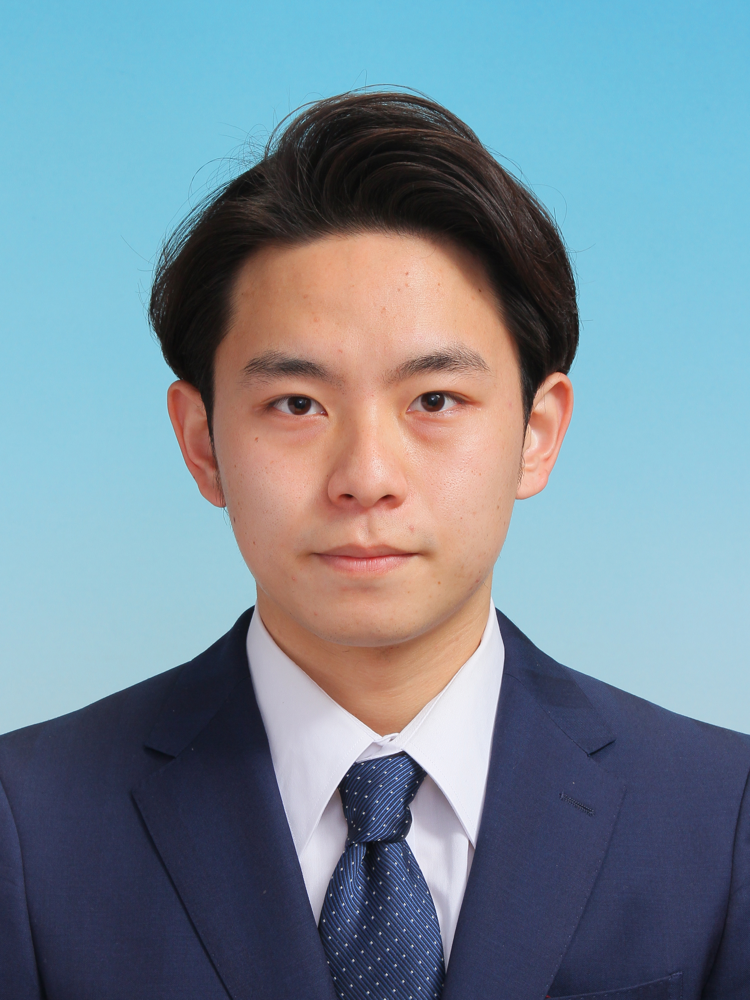

In [117]:
img = Image.open('masa.JPG')
img

In [63]:
with open('masa.JPG', 'rb') as f:
   binary_img = f.read()

In [64]:
#binary_img

In [69]:
headers = {
    'Content-Type':'application/octet-stream',
    'Ocp-Apim-Subscription-Key': subscription_key
}


params = {
   'returnFaceId': 'true',
    'returnFaceAttributes': 'age,gender,smile,facialHair,headPose,glasses,emotion,hair,makeup,occlusion,accessories,blur,exposure,noise',
}

res= requests.post(face_api_url, params=params,
                         headers=headers, data=binary_img)


In [94]:
res

<Response [200]>

In [95]:
result= res.json()
result

[{'faceId': 'cc830bb8-8f92-489c-838f-bac8d56cb597',
  'faceRectangle': {'top': 1132, 'left': 744, 'width': 1119, 'height': 1119},
  'faceAttributes': {'smile': 0.0,
   'headPose': {'pitch': -4.5, 'roll': -1.2, 'yaw': -1.9},
   'gender': 'male',
   'age': 21.0,
   'facialHair': {'moustache': 0.1, 'beard': 0.1, 'sideburns': 0.1},
   'glasses': 'NoGlasses',
   'emotion': {'anger': 0.0,
    'contempt': 0.0,
    'disgust': 0.0,
    'fear': 0.0,
    'happiness': 0.0,
    'neutral': 1.0,
    'sadness': 0.0,
    'surprise': 0.0},
   'blur': {'blurLevel': 'medium', 'value': 0.7},
   'exposure': {'exposureLevel': 'goodExposure', 'value': 0.63},
   'noise': {'noiseLevel': 'high', 'value': 1.0},
   'makeup': {'eyeMakeup': False, 'lipMakeup': False},
   'accessories': [],
   'occlusion': {'foreheadOccluded': False,
    'eyeOccluded': False,
    'mouthOccluded': False},
   'hair': {'bald': 0.17,
    'invisible': False,
    'hairColor': [{'color': 'black', 'confidence': 1.0},
     {'color': 'brown', 

In [96]:
rect=result[0]['faceRectangle']
rect

{'top': 1132, 'left': 744, 'width': 1119, 'height': 1119}

In [108]:
from PIL import ImageDraw

In [119]:
draw = ImageDraw.Draw(img)

In [120]:
# draw.line([(0,50),(200,50),(0,150),(200,150)],fill='red',width=5)
# img


In [121]:
rect


{'top': 1132, 'left': 744, 'width': 1119, 'height': 1119}

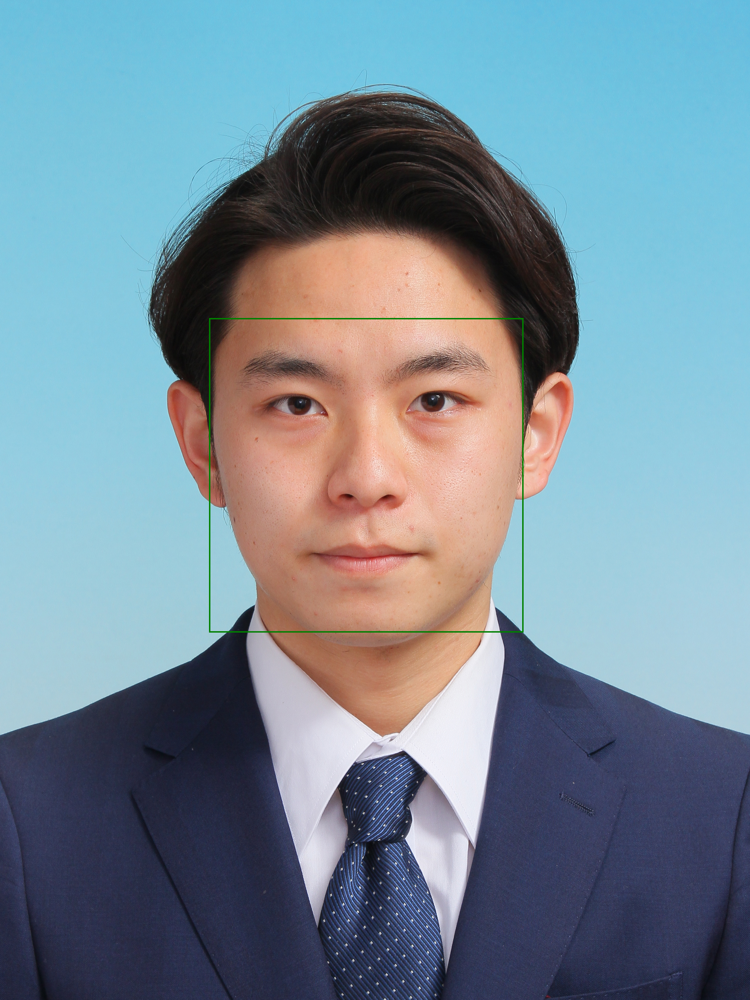

In [122]:
draw.rectangle([(rect['left'],rect['top']),(rect['left']+rect['width'],rect['top']+rect['height'])],fill=None,outline='green',width=5)
img

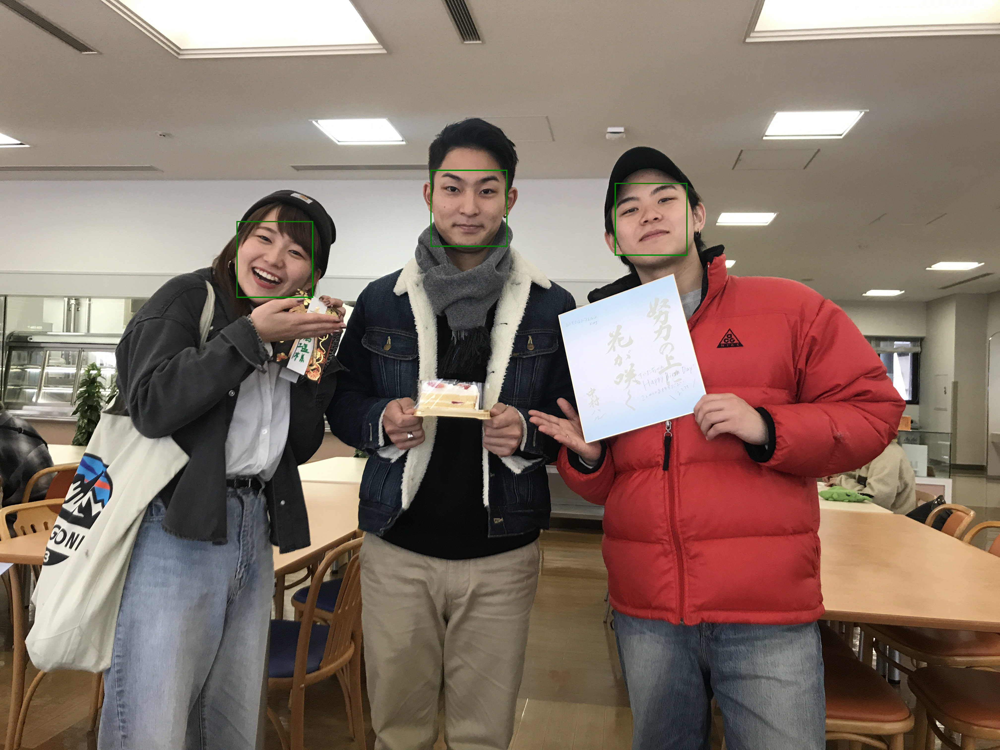

In [133]:
import requests
from PIL import Image
from PIL import ImageDraw
import io

subscription_key  = '8a93ee1742524393b229b209595ede7e'

assert subscription_key 

face_api_url=  'https://20210701masa.cognitiveservices.azure.com/face/v1.0/detect'

img = Image.open('masa03.JPG')

with io.BytesIO() as output:
    img.save(output,format="JPEG")
    binary_img= output.getvalue()#バイナリ取得

headers = {
    'Content-Type':'application/octet-stream',
    'Ocp-Apim-Subscription-Key': subscription_key
}


params = {
   'returnFaceId': 'true',
    'returnFaceAttributes': 'age,gender,smile,facialHair,headPose,glasses,emotion,hair,makeup,occlusion,accessories,blur,exposure,noise',
}

res= requests.post(face_api_url, params=params,headers=headers, data=binary_img)

result= res.json()
for result in results:
    
    rect=result['faceRectangle']


    draw = ImageDraw.Draw(img)
    draw.rectangle([(rect['left'],rect['top']),(rect['left']+rect['width'],rect['top']+rect['height'])],fill=None,outline='green',width=5)
img



In [136]:
import io

In [138]:
with io.BytesIO() as output:
    img.save(output,format="JPEG")
    binary_img= output.getvalue()#バイナリ取得

In [140]:
io.BytesIO()